In [2]:
# ipython glue and helpers

import cv2
import numpy as np
from scipy import spatial


def make_mask(b, image):
    mask = np.zeros((image.shape[0], image.shape[1], 1), dtype=np.uint8)
    for xx, yy in enumerate(b):
        mask[yy:, xx] = 255

    return mask


def display_mask(b, image, color=[0, 0, 255]):
    result = image.copy()
    overlay = np.full(image.shape, color, image.dtype)
    
    overlay = cv2.addWeighted(
        cv2.bitwise_and(overlay, overlay, mask=make_mask(b, image)),
        1,
        image,
        1,
        0,
        result
    )
    display(overlay)
    cv2.imwrite("temporary/result.png", overlay)
    
   


def display_cv2_image(image):
    # cv2.imwrite("result.png", image)
    return cv2.imencode('.png', image)[1].tostring()


ip = get_ipython()
png_f = ip.display_formatter.formatters['image/png']
png_f.for_type_by_name('numpy', 'ndarray', display_cv2_image);

In [3]:
def color_to_gradient(image):
    gray = cv2.cvtColor(input_image, cv2.COLOR_BGR2GRAY)
    return np.hypot(
        cv2.Sobel(gray, cv2.CV_64F, 1, 0),
        cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    )

In [4]:
def energy(b_tmp, image):
    sky_mask = make_mask(b_tmp, image)

    ground = np.ma.array(
        image,
        mask=cv2.cvtColor(cv2.bitwise_not(sky_mask), cv2.COLOR_GRAY2BGR)
    ).compressed()
    sky = np.ma.array(
        image,
        mask=cv2.cvtColor(sky_mask, cv2.COLOR_GRAY2BGR)
    ).compressed()
    ground.shape = (ground.size//3, 3)
    sky.shape = (sky.size//3, 3)

    sigma_g, mu_g = cv2.calcCovarMatrix(
        ground,
        None,
        cv2.COVAR_NORMAL | cv2.COVAR_ROWS | cv2.COVAR_SCALE
    )
    sigma_s, mu_s = cv2.calcCovarMatrix(
        sky,
        None,
        cv2.COVAR_NORMAL | cv2.COVAR_ROWS | cv2.COVAR_SCALE
    )

    y = 2

    return 1 / (
        (y * np.linalg.det(sigma_s) + np.linalg.det(sigma_g)) +
        (y * np.linalg.det(np.linalg.eig(sigma_s)[1]) +
            np.linalg.det(np.linalg.eig(sigma_g)[1]))
    )


In [5]:
def calculate_border(grad, t):
    sky = np.full(grad.shape[1], grad.shape[0])

    for x in range(grad.shape[1]):
        border_pos = np.argmax(grad[:, x] > t)

        # argmax hax return 0 if nothing is > t
        if border_pos > 0:
            sky[x] = border_pos

    return sky

In [6]:
def calculate_border_optimal(image, thresh_min=5, thresh_max=600, search_step=5):
    grad = color_to_gradient(image)

    n = ((thresh_max - thresh_min) // search_step) + 1

    b_opt = None
    jn_max = 0

    for k in range(1, n + 1):
        t = thresh_min + ((thresh_max - thresh_min) // n - 1) * (k - 1)

        b_tmp = calculate_border(grad, t)
        jn = energy(b_tmp, image)

        if jn > jn_max:
            jn_max = jn
            b_opt = b_tmp

    return b_opt

In [7]:
def no_sky_region(bopt, thresh1, thresh2, thresh3):
    border_ave = np.average(bopt)
    asadsbp = np.average(np.absolute(np.diff(bopt)))

    return border_ave < thresh1 or (border_ave < thresh2 and asadsbp > thresh3)


In [8]:
def partial_sky_region(bopt, thresh4):
    return np.any(np.diff(bopt) > thresh4)

In [10]:
def refine_sky(bopt, image):
    sky_mask = make_mask(bopt, image)

    ground = np.ma.array(
        image,
        mask=cv2.cvtColor(cv2.bitwise_not(sky_mask), cv2.COLOR_GRAY2BGR)
    ).compressed()
    sky = np.ma.array(
        image,
        mask=cv2.cvtColor(sky_mask, cv2.COLOR_GRAY2BGR)
    ).compressed()
    ground.shape = (ground.size//3, 3)
    sky.shape = (sky.size//3, 3)

    ret, label, center = cv2.kmeans(
        np.float32(sky),
        2,
        None,
        (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0),
        10,
        cv2.KMEANS_RANDOM_CENTERS
    )

    sigma_s1, mu_s1 = cv2.calcCovarMatrix(
        sky[label.ravel() == 0],
        None,
        cv2.COVAR_NORMAL | cv2.COVAR_ROWS | cv2.COVAR_SCALE
    )
    ic_s1 = cv2.invert(sigma_s1, cv2.DECOMP_SVD)[1]

    sigma_s2, mu_s2 = cv2.calcCovarMatrix(
        sky[label.ravel() == 1],
        None,
        cv2.COVAR_NORMAL | cv2.COVAR_ROWS | cv2.COVAR_SCALE
    )
    ic_s2 = cv2.invert(sigma_s2, cv2.DECOMP_SVD)[1]

    sigma_g, mu_g = cv2.calcCovarMatrix(
        ground,
        None,
        cv2.COVAR_NORMAL | cv2.COVAR_ROWS | cv2.COVAR_SCALE
    )
    icg = cv2.invert(sigma_g, cv2.DECOMP_SVD)[1]

    if cv2.Mahalanobis(mu_s1, mu_g, ic_s1) > cv2.Mahalanobis(mu_s2, mu_g, ic_s2):
        mu_s = mu_s1
        sigma_s = sigma_s1
        ics = ic_s1
    else:
        mu_s = mu_s2
        sigma_s = sigma_s2
        ics = ic_s2

    for x in range(image.shape[1]):
        cnt = np.sum(np.less(
            spatial.distance.cdist(
                image[0:bopt[x], x],
                mu_s,
                'mahalanobis',
                VI=ics
            ),
            spatial.distance.cdist(
                image[0:bopt[x], x],
                mu_g,
                'mahalanobis',
                VI=icg
            )
        ))

        if cnt < (bopt[x] / 2):
            bopt[x] = 0

    return bopt


C:\Users\ANIKET\AppData\Local\Temp\ipykernel_23076\1697533927.py:36: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  return cv2.imencode('.png', image)[1].tostring()


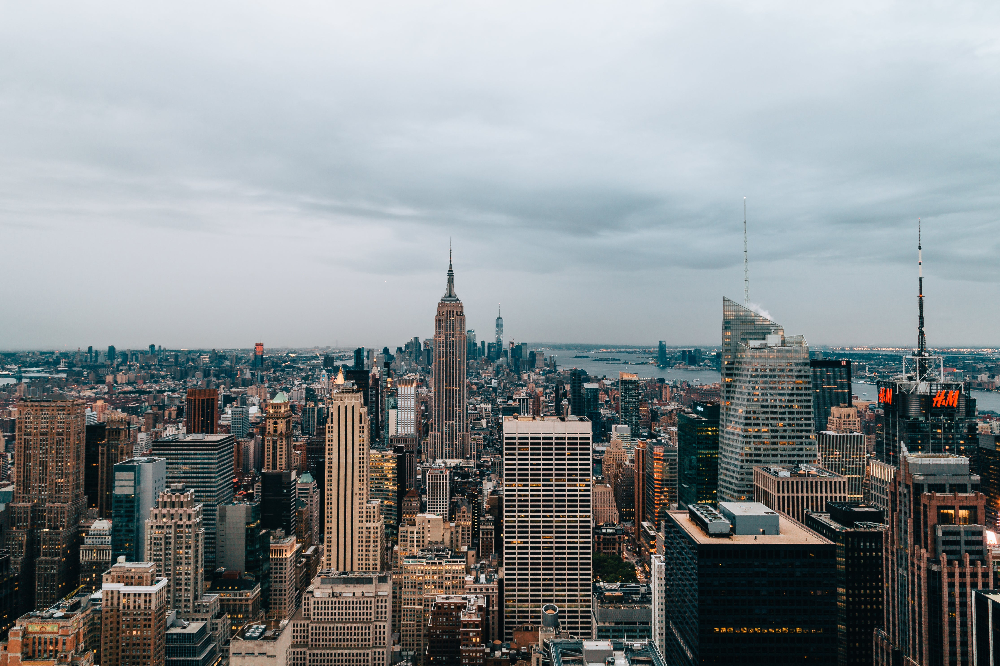

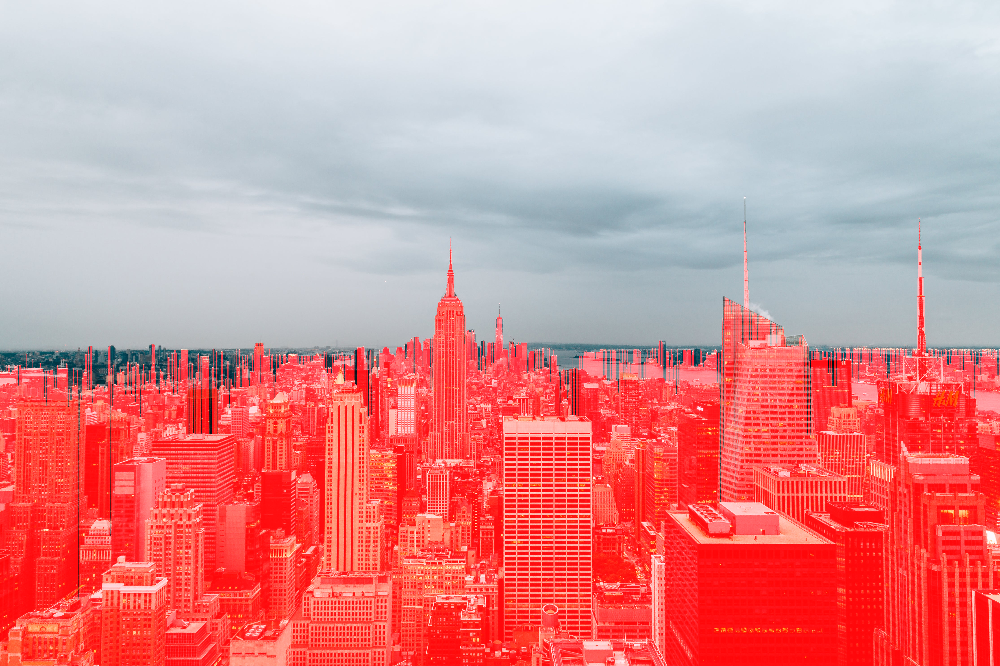

In [16]:
def detect_sky(image):
    display(input_image)

    bopt = calculate_border_optimal(image)

    if no_sky_region(bopt, image.shape[0]/30, image.shape[0]/4, 5):
        display("No sky detected")
        return

    display_mask(bopt, image)

    if partial_sky_region(bopt, image.shape[1]/3):
        bnew = refine_sky(bopt, image)

        display_mask(bnew, image)


# input_image = cv2.imread("fixtures/full_sky.png")
input_image = cv2.imread("Input Image with sky/img1.jpg")
# input_image = cv2.imread("fixtures/no_sky.png")

detect_sky(input_image)


In [18]:
sky_detected_img_path = 

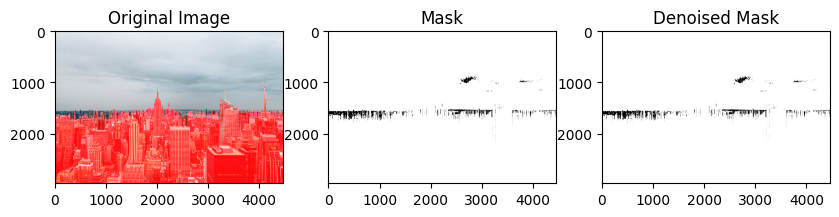

In [20]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def blue_shade_to_white(img):
    # Convert image to HSV color space
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # Define lower and upper bounds for blue color in HSV
    lower_blue = np.array([90, 50, 50])
    upper_blue = np.array([130, 255, 255])
    
    # Threshold the HSV image to get only blue colors
    mask = cv2.inRange(hsv, lower_blue, upper_blue)
    
    # Invert the mask to get blue regions as white and other regions as black
    mask = cv2.bitwise_not(mask)
    
    return mask

# Load the image
image = cv2.imread("Temporary/result.png")

# Convert blue shades to white and others to black
mask = blue_shade_to_white(image)

# Denoise the mask
denoised_mask = cv2.fastNlMeansDenoising(mask, None, 10, 7, 21)

# Show the original image, the resulting mask, and the denoised mask
plt.figure(figsize=(10, 5))

plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplot(1, 3, 2)
plt.imshow(mask, cmap='gray')
plt.title('Mask')

plt.subplot(1, 3, 3)
plt.imshow(denoised_mask, cmap='gray')
plt.title('Denoised Mask')

cv2.imwrite('Temporary/Denoised_image.jpg',denoised_mask)

plt.show()


True

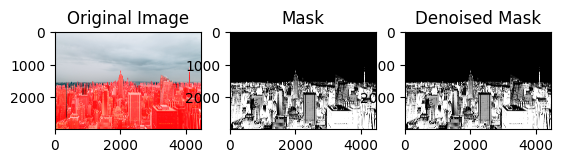

In [25]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Read the image
image = cv2.imread("Temporary/result.png")

# Convert the image to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Thresholding to extract blue shades (sky)
_, binary_image = cv2.threshold(gray_image, 100, 255, cv2.THRESH_BINARY)

# Invert the binary image
binary_image = cv2.bitwise_not(binary_image)

# Extract red regions
lower_red = np.array([0, 0, 100])
upper_red = np.array([80, 80, 255])
red_mask = cv2.inRange(image, lower_red, upper_red)

# Combine masks
combined_mask = cv2.bitwise_or(binary_image, red_mask)


denoised_mask = cv2.fastNlMeansDenoising(combined_mask, None, 10, 7, 21)

plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplot(1, 3, 2)
plt.imshow(combined_mask, cmap='gray')
plt.title('Mask')

plt.subplot(1, 3, 3)
plt.imshow(denoised_mask, cmap='gray')
plt.title('Denoised Mask')


cv2.imwrite('Temporary/Denoised_image.jpg',denoised_mask)


In [1]:
import cv2
import os
import tensorflow as tf
import numpy as np
import shutil
import matplotlib.pyplot as plt
import tensorflow_hub as hub

In [6]:
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'

In [7]:
hub_model = hub.load('https://kaggle.com/models/google/arbitrary-image-stylization-v1/frameworks/TensorFlow1/variations/256/versions/2')

In [8]:
content_image_path = 'Input Image with sky/img1.jpg'
style_image_path = 'Style Image/VincentVanGogh.jpg'

In [30]:
from matplotlib import gridspec
def show_n(images, titles=('',)):
  n = len(images)
  image_sizes = [image.shape[1] for image in images]
  w = (image_sizes[0] * 6) // 320
  plt.figure(figsize=(w * n, w))
  gs = gridspec.GridSpec(1, n, width_ratios=image_sizes)
  for i in range(n):
    plt.subplot(gs[i])
    plt.imshow(images[i][0], aspect='equal')
    plt.axis('off')
    plt.title(titles[i] if len(titles) > i else '')
  plt.show()

In [12]:
def load_img(path_to_img):
    max_dim = 1440
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)

    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim

    new_shape = tf.cast(shape * scale, tf.int32)

    img = tf.image.resize(img, new_shape)
    img = img[tf.newaxis, :]
    return img

In [13]:
content_image =  load_img(content_image_path)
style_image = load_img(style_image_path)

In [35]:
outputs = hub_model(tf.constant(content_image), tf.constant(style_image))
stylized_image = outputs[0]


In [38]:
stylized_image_np = tf.cast(stylized_image * 255, tf.uint8).numpy()
#encoded_image = cv2.cvtColor(stylized_image_np, cv2.COLOR_RGB2BGR)  
cv2.imwrite('Temporary/stylized_image.png', encoded_image)

True

In [14]:
stylized_images = hub_model(tf.constant(content_image), tf.constant(style_image))
stylized_image = tf.squeeze(stylized_images[0], axis=0) 

stylized_image_np = tf.cast(stylized_image * 255, tf.uint8).numpy()
encoded_image = cv2.cvtColor(stylized_image_np, cv2.COLOR_RGB2BGR)  
cv2.imwrite('Temporary/stylized_image.jpg', encoded_image)

True

In [ ]:
show_n([stylized_image], titles=['Stylized image'])

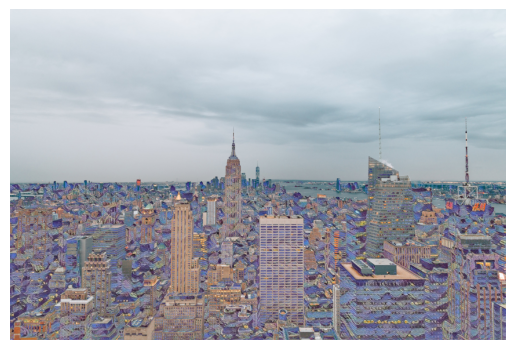

In [17]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

og_img = cv2.imread('Input Image with sky/img1.jpg')
stylized_image = cv2.imread('Temporary/stylized_image.jpg', cv2.IMREAD_COLOR)
mask_img = cv2.imread('Temporary/Denoised_image.jpg', cv2.IMREAD_GRAYSCALE)

height, width = og_img.shape[:2]
stylized_image_resized = cv2.resize(stylized_image, (width, height))
mask_img_resized = cv2.resize(mask_img, (width, height))
_, mask_binary = cv2.threshold(mask_img_resized, 127, 255, cv2.THRESH_BINARY)
mask_inv = cv2.bitwise_not(mask_binary)
result = og_img.copy()
result[mask_binary != 0] = stylized_image_resized[mask_binary != 0]

plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

cv2.imwrite("Output Folder/final_output_image_invert.jpg",result)

plt.axis('off')
plt.show()


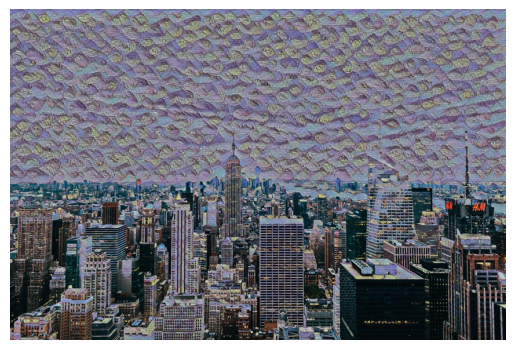

In [15]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

og_img = cv2.imread('Input Image with sky/img1.jpg')
stylized_image = cv2.imread('Temporary/stylized_image.jpg', cv2.IMREAD_COLOR)
mask_img = cv2.imread('Temporary/Denoised_image.jpg', cv2.IMREAD_GRAYSCALE)

height, width = og_img.shape[:2]
stylized_image_resized = cv2.resize(stylized_image, (width, height))
mask_img_resized = cv2.resize(mask_img, (width, height))

_, mask_binary = cv2.threshold(mask_img_resized, 127, 255, cv2.THRESH_BINARY)
mask_inv = cv2.bitwise_not(mask_binary)
result = og_img.copy()
result[mask_binary == 0] = stylized_image_resized[mask_binary == 0]

plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

cv2.imwrite("Output Folder/final_output_image.jpg",result)
plt.axis('off')
plt.show()
